In [ ]:
#!pip uninstall tensorflow -y
#!pip install tensorflow==2.12.0

In [ ]:
import tensorflow as tf
print(tf.__version__)

2.12.0


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


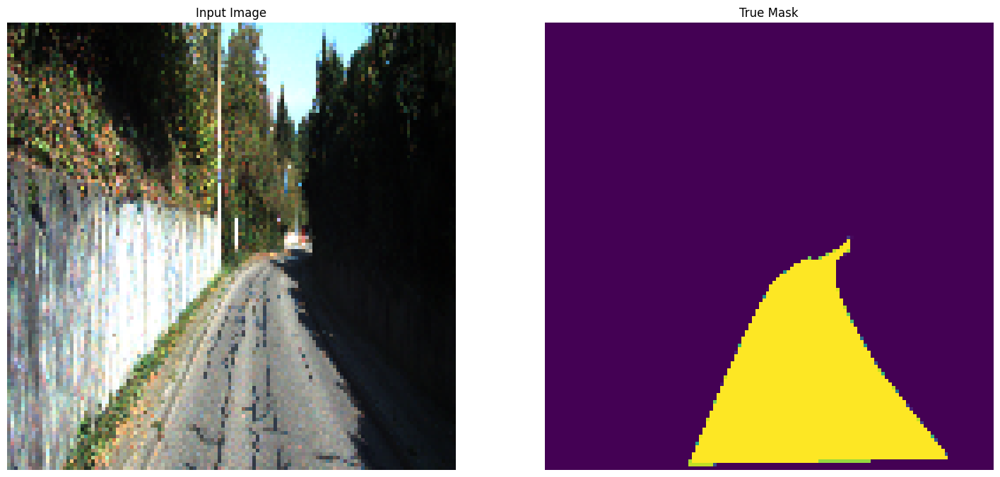

In [ ]:

# Import necessary libraries
import tensorflow as tf
import numpy as np
import os
import cv2
import datetime
from tensorflow.keras.layers import Conv2D, UpSampling2D, Concatenate, Input
from tensorflow.keras.models import Model
from tensorflow.keras.applications import VGG16, ResNet50
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy
from tensorflow.keras import callbacks
from matplotlib import pyplot as plt
from IPython.display import clear_output

# KITTI dataset paths
train_data_dir = "/content/drive/MyDrive/ComputerVisionProjects/KITTI/training/image_2/"
train_gt_dir = "/content/drive/MyDrive/ComputerVisionProjects/KITTI/training/gt_image_2/"
test_data_dir = "/content/drive/MyDrive/ComputerVisionProjects/KITTI/testing/"

# Number of training examples
TRAINSET_SIZE = int(len(os.listdir(train_data_dir)) * 0.8)
VALIDSET_SIZE = int(len(os.listdir(train_data_dir)) * 0.1)
TESTSET_SIZE = int(len(os.listdir(train_data_dir)) - TRAINSET_SIZE - VALIDSET_SIZE)

# Initialize Constants
IMG_SIZE = 128
N_CHANNELS = 3
N_CLASSES = 1
SEED = 123

# Function to load image and return a dictionary
def parse_image(img_path: str) -> dict:
    image = tf.io.read_file(img_path)
    image = tf.image.decode_jpeg(image, channels=3)
    image = tf.image.convert_image_dtype(image, tf.uint8)

    mask_path = tf.strings.regex_replace(img_path, "image_2", "gt_image_2")
    mask_path = tf.strings.regex_replace(mask_path, "um_", "um_road_")
    mask_path = tf.strings.regex_replace(mask_path, "umm_", "umm_road_")
    mask_path = tf.strings.regex_replace(mask_path, "uu_", "uu_road_")

    mask = tf.io.read_file(mask_path)
    mask = tf.image.decode_png(mask, channels=3)

    road_label = np.array([255, 0, 255])

    mask = tf.experimental.numpy.all(mask == road_label, axis=2)
    mask = tf.cast(mask, tf.uint8)
    mask = tf.expand_dims(mask, axis=-1)

    return {'image': image, 'segmentation_mask': mask}

# Generate dataset variables
all_dataset = tf.data.Dataset.list_files(train_data_dir + "*.png", seed=SEED)
all_dataset = all_dataset.map(parse_image)

train_dataset = all_dataset.take(TRAINSET_SIZE + VALIDSET_SIZE)
val_dataset = train_dataset.skip(TRAINSET_SIZE)
train_dataset = train_dataset.take(TRAINSET_SIZE)
test_dataset = all_dataset.skip(TRAINSET_SIZE + VALIDSET_SIZE)

# TensorFlow function to rescale images to [0, 1]
@tf.function
def normalize(input_image: tf.Tensor, input_mask: tf.Tensor) -> tuple:
    input_image = tf.cast(input_image, tf.float32) / 255.0
    return input_image, input_mask

# TensorFlow function to apply preprocessing transformations
@tf.function
def load_image_train(datapoint: dict) -> tuple:
    input_image = tf.image.resize(datapoint['image'], (IMG_SIZE, IMG_SIZE))
    input_mask = tf.image.resize(datapoint['segmentation_mask'], (IMG_SIZE, IMG_SIZE))

    if tf.random.uniform(()) > 0.5:
        input_image = tf.image.flip_left_right(input_image)
        input_mask = tf.image.flip_left_right(input_mask)

    input_image, input_mask = normalize(input_image, input_mask)

    return input_image, input_mask

# TensorFlow function to preprocess validation images
@tf.function
def load_image_test(datapoint: dict) -> tuple:
    input_image = tf.image.resize(datapoint['image'], (IMG_SIZE, IMG_SIZE))
    input_mask = tf.image.resize(datapoint['segmentation_mask'], (IMG_SIZE, IMG_SIZE))

    input_image, input_mask = normalize(input_image, input_mask)

    return input_image, input_mask

BATCH_SIZE = 32
BUFFER_SIZE = 1000

dataset = {"train": train_dataset, "val": val_dataset, "test": test_dataset}

# -- Train Dataset --#
dataset['train'] = dataset['train'].map(load_image_train, num_parallel_calls=tf.data.AUTOTUNE)
dataset['train'] = dataset['train'].shuffle(buffer_size=BUFFER_SIZE, seed=SEED)
dataset['train'] = dataset['train'].repeat()
dataset['train'] = dataset['train'].batch(BATCH_SIZE)
dataset['train'] = dataset['train'].prefetch(buffer_size=tf.data.AUTOTUNE)

#-- Validation Dataset --#
dataset['val'] = dataset['val'].map(load_image_test)
dataset['val'] = dataset['val'].repeat()
dataset['val'] = dataset['val'].batch(BATCH_SIZE)
dataset['val'] = dataset['val'].prefetch(buffer_size=tf.data.AUTOTUNE)

#-- Testing Dataset --#
dataset['test'] = dataset['test'].map(load_image_test)
dataset['test'] = dataset['test'].batch(BATCH_SIZE)
dataset['test'] = dataset['test'].prefetch(buffer_size=tf.data.AUTOTUNE)

# Function to view the images from the directory
def display_sample(display_list):
    plt.figure(figsize=(18, 18))

    title = ['Input Image', 'True Mask', 'Predicted Mask']

    for i in range(len(display_list)):
        plt.subplot(1, len(display_list), i+1)
        plt.title(title[i])
        plt.imshow(tf.keras.preprocessing.image.array_to_img(display_list[i]))
        plt.axis('off')

    plt.show()

for image, mask in dataset["train"].take(1):
    sample_image, sample_mask = image, mask

display_sample([sample_image[0], sample_mask[0]])

In [ ]:
from tensorflow.keras.applications import VGG16, ResNet50
from tensorflow.keras.layers import Input, UpSampling2D, Concatenate, Conv2D, AveragePooling2D
from tensorflow.keras.models import Model


# Define the fusion model combining ResNet50 and PSPNet (based on VGG16)
def build_fusion_model(input_shape, n_classes):
    # Input layer
    inputs = Input(shape=input_shape)


    # ResNet-50 backbone
    resnet_model = ResNet50(include_top=False, weights='imagenet', input_tensor=inputs)
    res_c1 = resnet_model.get_layer("conv2_block3_out").output  # 1/4 size
    res_c2 = resnet_model.get_layer("conv3_block4_out").output  # 1/8 size
    res_c3 = resnet_model.get_layer("conv4_block6_out").output  # 1/16 size
    res_c4 = resnet_model.get_layer("conv5_block3_out").output  # 1/32 size


    # VGG-16 backbone for PSPNet
    vgg16_model = VGG16(include_top=False, weights='imagenet', input_tensor=inputs)
    vgg_c1 = vgg16_model.get_layer("block3_pool").output  # 1/8 size
    vgg_c2 = vgg16_model.get_layer("block4_pool").output  # 1/16 size
    vgg_c3 = vgg16_model.get_layer("block5_pool").output  # 1/32 size


    # PSPNet Pyramid Pooling Module for VGG-16
    pool1 = AveragePooling2D(pool_size=(2, 2))(vgg_c3)  # 1/64 size
    pool1 = Conv2D(512, (1, 1), padding='same')(pool1)
    pool1 = UpSampling2D(size=(2, 2), interpolation='bilinear')(pool1)  # 1/32 size


    pool2 = AveragePooling2D(pool_size=(2, 2))(vgg_c3)  # 1/64 size
    pool2 = Conv2D(512, (1, 1), padding='same')(pool2)
    pool2 = UpSampling2D(size=(2, 2), interpolation='bilinear')(pool2)  # 1/32 size


    pool3 = AveragePooling2D(pool_size=(2, 2))(vgg_c3)  # 1/64 size
    pool3 = Conv2D(512, (1, 1), padding='same')(pool3)
    pool3 = UpSampling2D(size=(2, 2), interpolation='bilinear')(pool3)  # 1/32 size


    # Concatenate the pyramid pooling outputs
    psp_x = Concatenate()([pool1, pool2, pool3, vgg_c3])
    psp_x = Conv2D(512, (3, 3), padding='same')(psp_x)  # 1/32 size


    # Fusion of ResNet and PSPNet features
    fusion_c4 = Concatenate()([res_c4, psp_x])  # 1/32 size
    u1 = UpSampling2D((2, 2), interpolation='bilinear')(fusion_c4)
    fusion_c3 = Concatenate()([u1, res_c3, vgg_c2])  # 1/16 size


    u2 = UpSampling2D((2, 2), interpolation='bilinear')(fusion_c3)
    fusion_c2 = Concatenate()([u2, res_c2, vgg_c1])  # 1/8 size


    u3 = UpSampling2D((2, 2), interpolation='bilinear')(fusion_c2)
    fusion_c1 = Concatenate()([u3, res_c1])  # 1/4 size


    u4 = UpSampling2D((4, 4), interpolation='bilinear')(fusion_c1)
    outputs = Conv2D(n_classes, (1, 1), activation='sigmoid')(u4)


    model = Model(inputs=inputs, outputs=outputs, name="ResNet_PSPNet_Fusion")


    return model


# Define input shape
input_shape = (IMG_SIZE, IMG_SIZE, N_CHANNELS)
n_classes = N_CLASSES


# Build and compile the fusion model
model = build_fusion_model(input_shape, n_classes)
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])


# Display model summary
model.summary()

Model: "ResNet_PSPNet_Fusion"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_7 (InputLayer)           [(None, 128, 128, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 134, 134, 3)  0           ['input_7[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 64, 64, 64)   9472        ['conv1_pad[0][0]']              
                                                                                                  
 conv1_bn (BatchNormalization)  (None, 64, 64, 64)   256         ['conv1_conv[0

In [ ]:
#training
m_iou = tf.keras.metrics.MeanIoU(2)
model.compile(optimizer=Adam(),
              loss=BinaryCrossentropy(),
              metrics=[m_iou])

# Function to create a mask out of network prediction
def create_mask(pred_mask: tf.Tensor) -> tf.Tensor:
    pred_mask = tf.math.round(pred_mask)
    pred_mask = tf.expand_dims(pred_mask, axis=-1)
    return pred_mask

1/1 [==============================] - 17s 17s/step


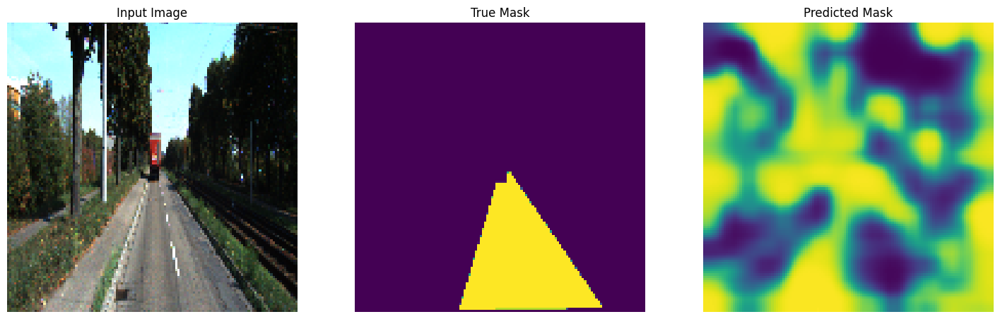

In [ ]:
# Function to show predictions
def show_predictions(dataset=None, num=1):
    if dataset:
        for image, mask in dataset.take(num):
            pred_mask = model.predict(image)
            display_sample([image[0], mask, create_mask(pred_mask)])
    else:
        inference = model.predict(sample_image)
        display_sample([sample_image[0], sample_mask[0], inference[0]])

for image, mask in dataset['train'].take(1):
    sample_image, sample_mask = image, mask

show_predictions()

In [ ]:
# Callbacks and Logs
class DisplayCallback(callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        clear_output(wait=True)
        show_predictions()
        print ('\nSample Prediction after epoch {}\n'.format(epoch+1))

logdir = os.path.join("logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

callbacks_list = [
    DisplayCallback(),
    callbacks.TensorBoard(logdir, histogram_freq = -1),
    callbacks.EarlyStopping(patience = 10, verbose = 1),
    callbacks.ModelCheckpoint('best_model.h5', verbose = 1, save_best_only = True)
]


1/1 [==============================] - 9s 9s/step


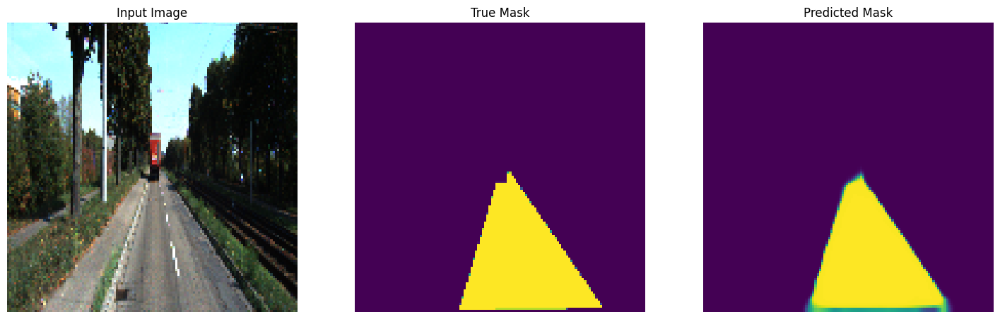


Sample Prediction after epoch 200



7/7 [==============================] - 209s 31s/step - loss: 0.0113 - mean_io_u_5: 0.7831


In [ ]:
# Set Variables
EPOCHS = 200
STEPS_PER_EPOCH = TRAINSET_SIZE // BATCH_SIZE
VALIDATION_STEPS = VALIDSET_SIZE // BATCH_SIZE

model_history = model.fit(dataset['train'], epochs=EPOCHS,
                          steps_per_epoch=STEPS_PER_EPOCH,
                          validation_data = dataset["val"],
                          validation_steps=VALIDATION_STEPS,
                          callbacks = callbacks_list)

In [ ]:
import numpy as np
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score, average_precision_score

# Function to calculate metrics
def calculate_metrics(y_true, y_pred):
    # Ensure that y_true is binarized (if it's not already binary)
    y_true = (y_true >= 0.5).astype(int)  # Fixes the issue by binarizing y_true

    # Ensure that y_pred is binarized by applying a threshold
    y_pred = (y_pred >= 0.5).astype(int)

    # Flatten the arrays to 1D arrays
    y_true = y_true.flatten()
    y_pred = y_pred.flatten()

    # Calculate metrics
    precision = precision_score(y_true, y_pred)
    recall = recall_score(y_true, y_pred)
    f1 = f1_score(y_true, y_pred)
    iou = np.sum((y_true & y_pred)) / np.sum((y_true | y_pred))
    ap = average_precision_score(y_true, y_pred)
    accuracy = accuracy_score(y_true, y_pred)

    return precision, recall, f1, iou, ap, accuracy

# Function to evaluate model on the test set
def evaluate_model(model, dataset):
    y_trues = []
    y_preds = []

    for image, mask in dataset:
        pred_mask = model.predict(image)
        pred_mask = (pred_mask >= 0.5).astype(int)

        y_trues.append(mask.numpy())
        y_preds.append(pred_mask)

    y_true = np.concatenate(y_trues, axis=0)
    y_pred = np.concatenate(y_preds, axis=0)

    precision, recall, f1, iou, ap, accuracy = calculate_metrics(y_true, y_pred)

    return precision, recall, f1, iou, ap, accuracy, y_true, y_pred

In [ ]:
# Ensure that y_true and y_pred are binary and flattened
y_true = (y_true >= 0.5).astype(int).flatten()
y_pred = (y_pred >= 0.5).astype(int).flatten()

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, roc_auc_score, roc_curve, precision_recall_curve

# Evaluate the model and ensure binarization
precision, recall, f1, iou, ap, accuracy, y_true, y_pred = evaluate_model(model, dataset['test'])

# Ensure that y_true and y_pred are binary and flattened
y_true = (y_true >= 0.5).astype(int).flatten()
y_pred = (y_pred >= 0.5).astype(int).flatten()

# Print the metrics
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"Max F1 Score: {f1:.4f}")
print(f"IoU: {iou:.4f}")
print(f"AP (Average Precision): {ap:.4f}")
print(f"Accuracy: {accuracy:.4f}")

1/1 [==============================] - 10s 10s/step
Precision: 0.9805
Recall: 0.9927
Max F1 Score: 0.9865
IoU: 0.9734
AP (Average Precision): 0.9746
Accuracy: 0.9952


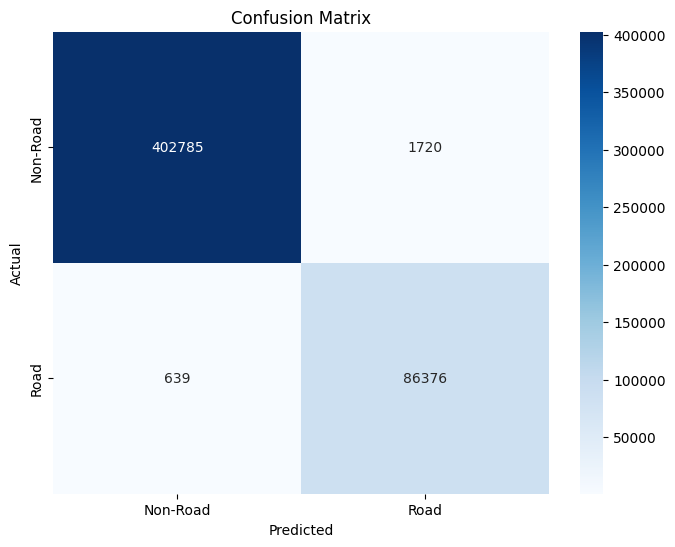

In [ ]:
# Confusion Matrix
cm = confusion_matrix(y_true, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['Non-Road', 'Road'], yticklabels=['Non-Road', 'Road'])
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

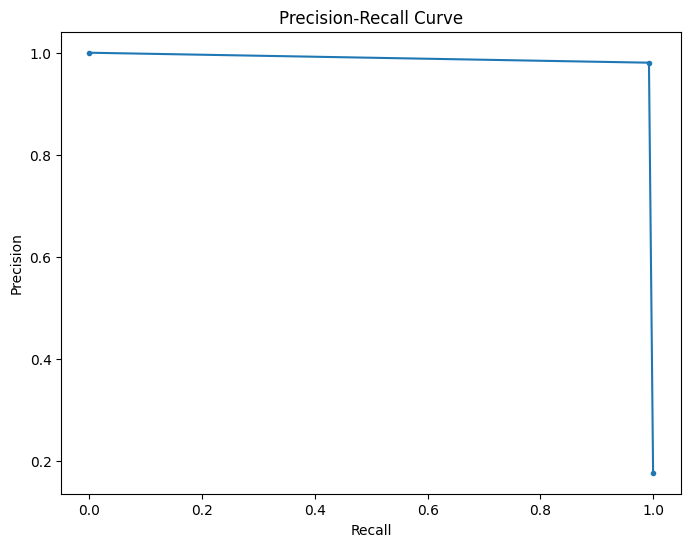

In [ ]:
# Precision-Recall Curve
precision_vals, recall_vals, _ = precision_recall_curve(y_true, y_pred)
plt.figure(figsize=(8, 6))
plt.plot(recall_vals, precision_vals, marker='.')
plt.title('Precision-Recall Curve')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.show()

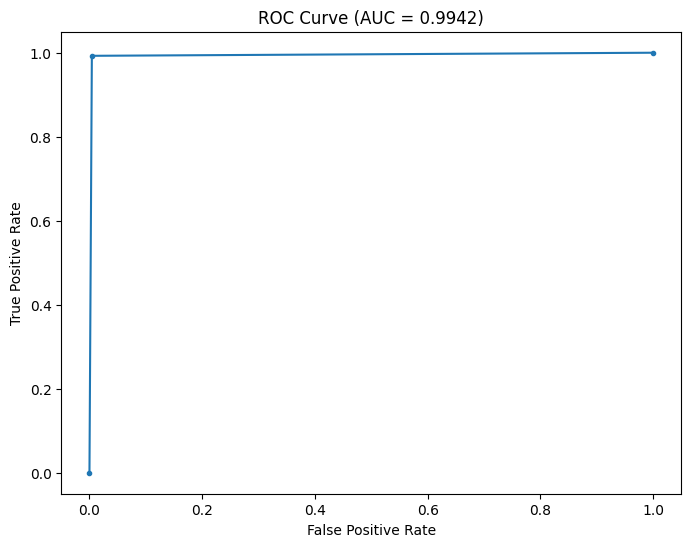

In [ ]:
# ROC Curve
fpr, tpr, _ = roc_curve(y_true, y_pred)
auc_score = roc_auc_score(y_true, y_pred)
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, marker='.')
plt.title(f'ROC Curve (AUC = {auc_score:.4f})')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.show()

In [ ]:
# Dice Coefficient Calculation
def dice_coefficient(y_true, y_pred):
    intersection = np.sum(y_true * y_pred)
    return (2. * intersection) / (np.sum(y_true) + np.sum(y_pred))

dice = dice_coefficient(y_true, y_pred)
print(f"Dice Coefficient: {dice:.4f}")

Dice Coefficient: 0.9865


In [ ]:
# Statistical Summary
metrics = {
    'Precision': precision,
    'Recall': recall,
    'F1 Score': f1,
    'IoU': iou,
    'AP (Average Precision)': ap,
    'Accuracy': accuracy,
    'Dice Coefficient': dice
}


In [ ]:
# Calculate the mean, variance, and standard deviation
for metric_name, value in metrics.items():
    print(f"{metric_name}:")
    print(f"  Mean: {np.mean(value):.4f}")
    print(f"  Variance: {np.var(value):.4f}")
    print(f"  Standard Deviation: {np.std(value):.4f}")

Precision:
  Mean: 0.9805
  Variance: 0.0000
  Standard Deviation: 0.0000
Recall:
  Mean: 0.9927
  Variance: 0.0000
  Standard Deviation: 0.0000
F1 Score:
  Mean: 0.9865
  Variance: 0.0000
  Standard Deviation: 0.0000
IoU:
  Mean: 0.9734
  Variance: 0.0000
  Standard Deviation: 0.0000
AP (Average Precision):
  Mean: 0.9746
  Variance: 0.0000
  Standard Deviation: 0.0000
Accuracy:
  Mean: 0.9952
  Variance: 0.0000
  Standard Deviation: 0.0000
Dice Coefficient:
  Mean: 0.9865
  Variance: 0.0000
  Standard Deviation: 0.0000


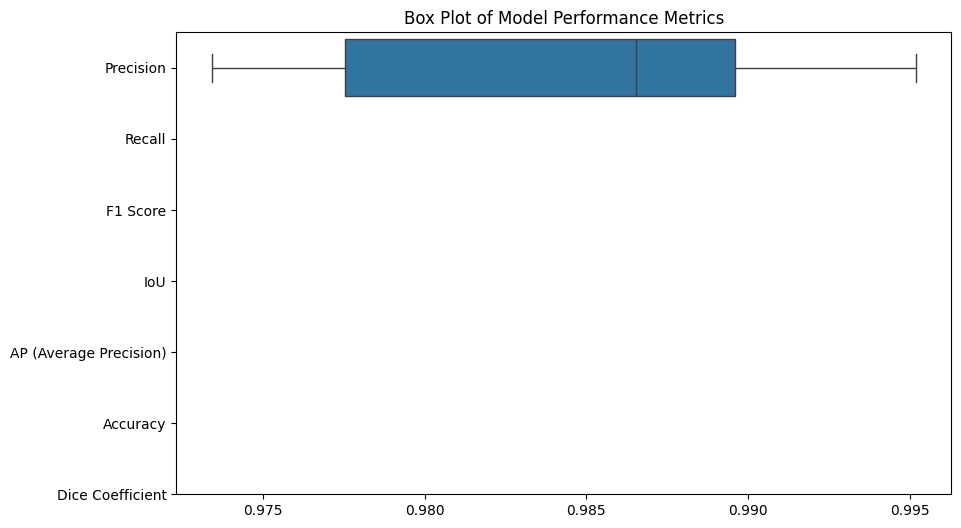

In [ ]:
# Boxplot of the metrics
plt.figure(figsize=(10, 6))
sns.boxplot(data=list(metrics.values()), orient='h')
plt.yticks(ticks=range(len(metrics)), labels=metrics.keys())
plt.title('Box Plot of Model Performance Metrics')
plt.show()

In [ ]:
# Measure Speed
import time

def measure_speed(model, dataset):
    start_time = time.time()
    for image, mask in dataset.take(1):
        _ = model.predict(image)
    end_time = time.time()

    time_per_image = (end_time - start_time) * 1000 / BATCH_SIZE  # in ms
    fps = 1000 / time_per_image  # in Hz

    return time_per_image, fps

time_per_image, fps = measure_speed(model, dataset['test'])

print(f"Speed per image: {time_per_image:.2f} ms")
print(f"Speed: {fps:.2f} fps")

1/1 [==============================] - 16s 16s/step
Speed per image: 562.70 ms
Speed: 1.78 fps


In [ ]:
# Processing Time for entire test set
def measure_processing_time(model, dataset):
    start_time = time.time()
    for image, mask in dataset:
        _ = model.predict(image)
    end_time = time.time()

    processing_time = (end_time - start_time) * 1000  # in ms
    return processing_time

processing_time = measure_processing_time(model, dataset['test'])
print(f"Processing Time for Test Set: {processing_time:.2f} ms")

1/1 [==============================] - 16s 16s/step
Processing Time for Test Set: 17950.25 ms


In [ ]:
pixel_accuracy = np.mean(y_true == y_pred)
print(f"Pixel Accuracy: {pixel_accuracy:.4f}")

Pixel Accuracy: 0.9952


In [ ]:
from scipy.spatial.distance import directed_hausdorff

def hausdorff_distance(y_true, y_pred):
    true_coords = np.argwhere(y_true)
    pred_coords = np.argwhere(y_pred)
    if len(true_coords) == 0 or len(pred_coords) == 0:
        return np.nan
    return max(directed_hausdorff(true_coords, pred_coords)[0],
               directed_hausdorff(pred_coords, true_coords)[0])

hd = hausdorff_distance(y_true, y_pred)
print(f"Hausdorff Distance: {hd:.4f}")

Hausdorff Distance: 511.0000


1/1 [==============================] - 12s 12s/step


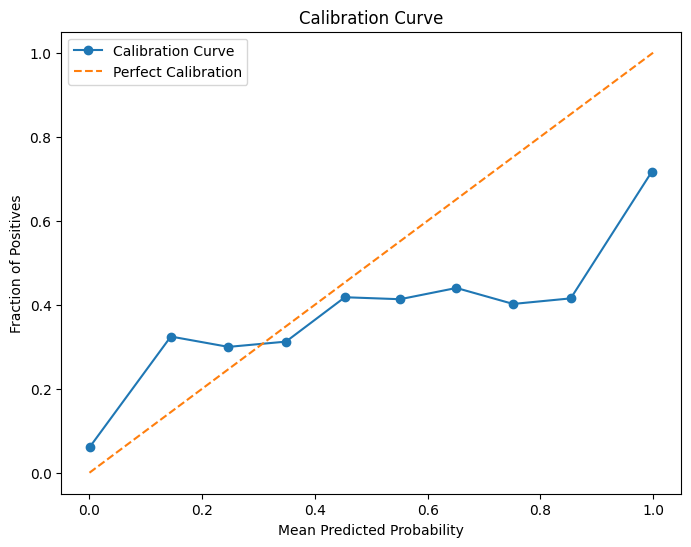

In [ ]:
from sklearn.calibration import calibration_curve

# Assuming model.predict returns probabilities
y_probs = model.predict(dataset['test'])  # Shape: (num_samples, ...)

# Flatten probabilities and true labels
y_probs_flat = y_probs.flatten()
y_true_flat = y_true.flatten()

# Compute calibration curve
prob_true, prob_pred = calibration_curve(y_true_flat, y_probs_flat, n_bins=10)

plt.figure(figsize=(8, 6))
plt.plot(prob_pred, prob_true, marker='o', label='Calibration Curve')
plt.plot([0, 1], [0, 1], linestyle='--', label='Perfect Calibration')
plt.xlabel('Mean Predicted Probability')
plt.ylabel('Fraction of Positives')
plt.title('Calibration Curve')
plt.legend()
plt.show()

Optimal Threshold for F1 Score: 0.01


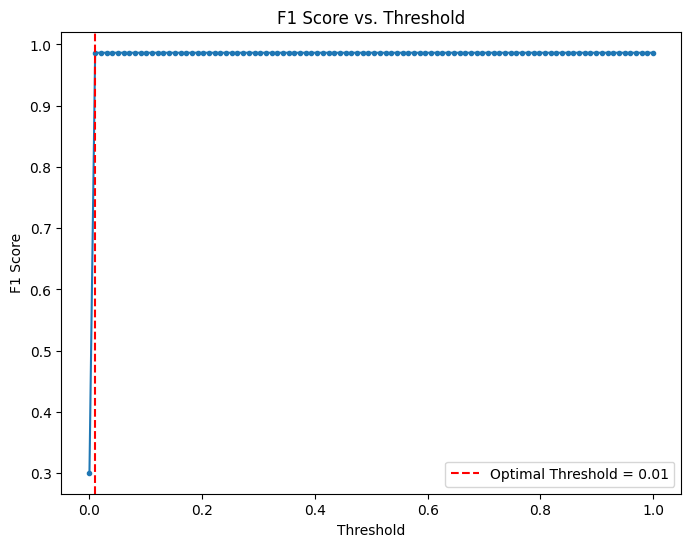

Metrics at Optimal Threshold (0.01):
Precision: 0.6661
Recall: 0.7336
F1 Score: 0.6982
IoU: 0.5363
AP (Average Precision): 0.5358
Accuracy: 0.8877


In [ ]:
from sklearn.metrics import f1_score

thresholds = np.linspace(0, 1, 100)
f1_scores = [f1_score(y_true, y_pred >= t) for t in thresholds]

optimal_idx = np.argmax(f1_scores)
optimal_threshold = thresholds[optimal_idx]
print(f"Optimal Threshold for F1 Score: {optimal_threshold:.2f}")

# Plot F1 Score vs. Threshold
plt.figure(figsize=(8, 6))
plt.plot(thresholds, f1_scores, marker='.')
plt.axvline(optimal_threshold, color='red', linestyle='--', label=f'Optimal Threshold = {optimal_threshold:.2f}')
plt.xlabel('Threshold')
plt.ylabel('F1 Score')
plt.title('F1 Score vs. Threshold')
plt.legend()
plt.show()

# Recalculate metrics using the optimal threshold
y_pred_optimal = (y_probs_flat >= optimal_threshold).astype(int)
precision_opt, recall_opt, f1_opt, iou_opt, ap_opt, accuracy_opt = calculate_metrics(y_true_flat, y_pred_optimal)
print(f"Metrics at Optimal Threshold ({optimal_threshold:.2f}):")
print(f"Precision: {precision_opt:.4f}")
print(f"Recall: {recall_opt:.4f}")
print(f"F1 Score: {f1_opt:.4f}")
print(f"IoU: {iou_opt:.4f}")
print(f"AP (Average Precision): {ap_opt:.4f}")
print(f"Accuracy: {accuracy_opt:.4f}")

In [ ]:
# Function to calculate mask over image
def weighted_img(img, initial_img, α=1., β=0.5, γ=0.):
    return cv2.addWeighted(initial_img, α, img, β, γ)

# Function to process an individual image and it's mask
def process_image_mask(image, mask):
    # Round to closest
    mask = tf.math.round(mask)

    # Convert to mask image
    zero_image = np.zeros_like(mask)
    mask = np.dstack((mask, zero_image, zero_image))
    mask = np.asarray(mask, np.float32)

    # Convert to image image
    image = np.asarray(image, np.float32)

    # Get the final image
    final_image = weighted_img(mask, image)

    return final_image

In [ ]:
# Function to save predictions
def save_predictions(dataset):
    # Predict and save image the from input dataset
    index = 0
    for batch_image, batch_mask in dataset:
        for image, mask in zip(batch_image, batch_mask):
            print(f"Processing image : {index}")
            pred_mask = model.predict(tf.expand_dims(image, axis = 0))
            save_sample([image, process_image_mask(image, pred_mask[0])], index)
            index += 1

# Function to save the images as a plot
def save_sample(display_list, index):
    plt.figure(figsize=(18, 18))

    title = ['Input Image', 'Predicted Mask']

    for i in range(len(display_list)):
        plt.subplot(1, len(display_list), i+1)
        plt.title(title[i])
        plt.imshow(tf.keras.preprocessing.image.array_to_img(display_list[i]))
        plt.axis('off')

    plt.savefig(f"/content/drive/MyDrive/ComputerVisionProjects/final_outputs/{index}.png")
    plt.show()

Processing image : 0
1/1 [==============================] - 0s 411ms/step


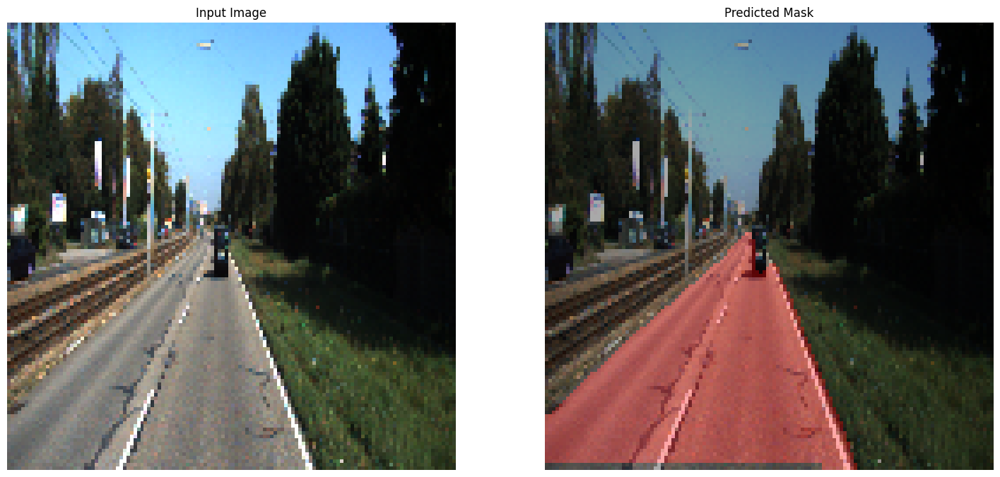

Processing image : 1
1/1 [==============================] - 0s 370ms/step


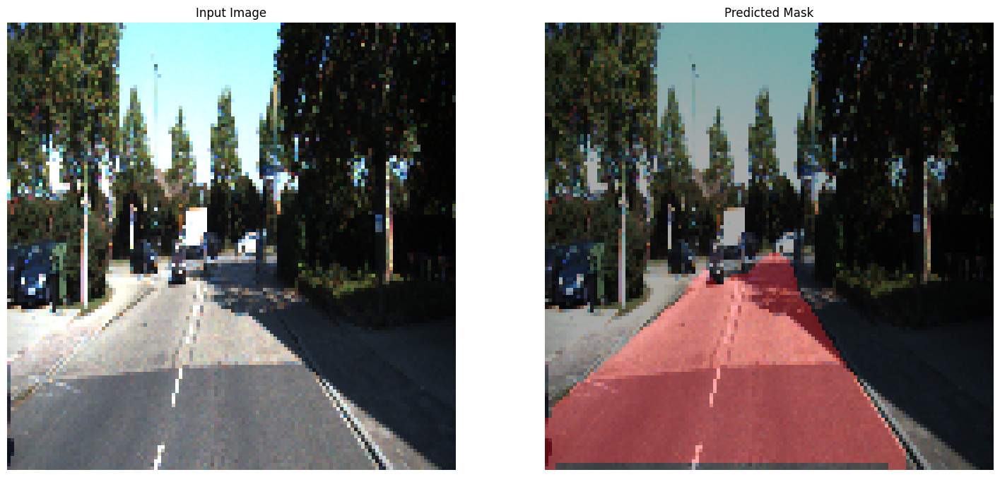

Processing image : 2
1/1 [==============================] - 0s 350ms/step


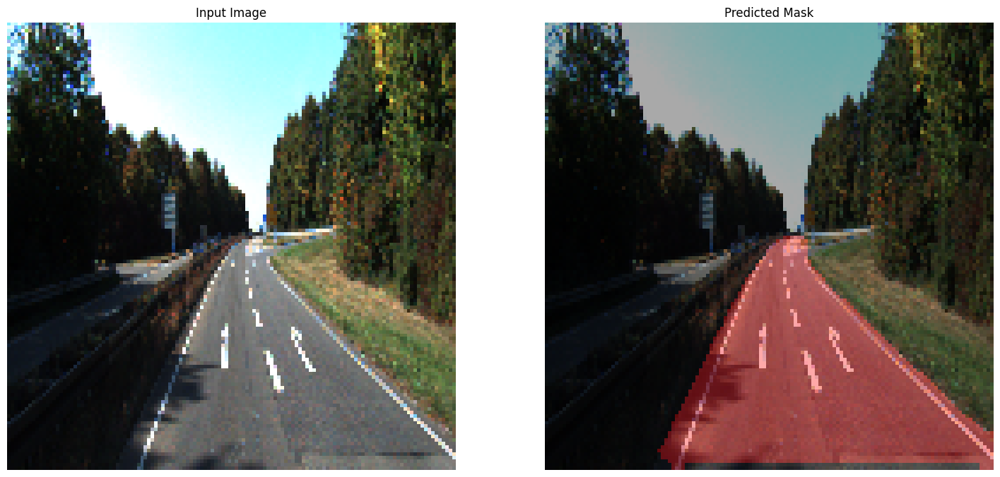

Processing image : 3
1/1 [==============================] - 0s 340ms/step


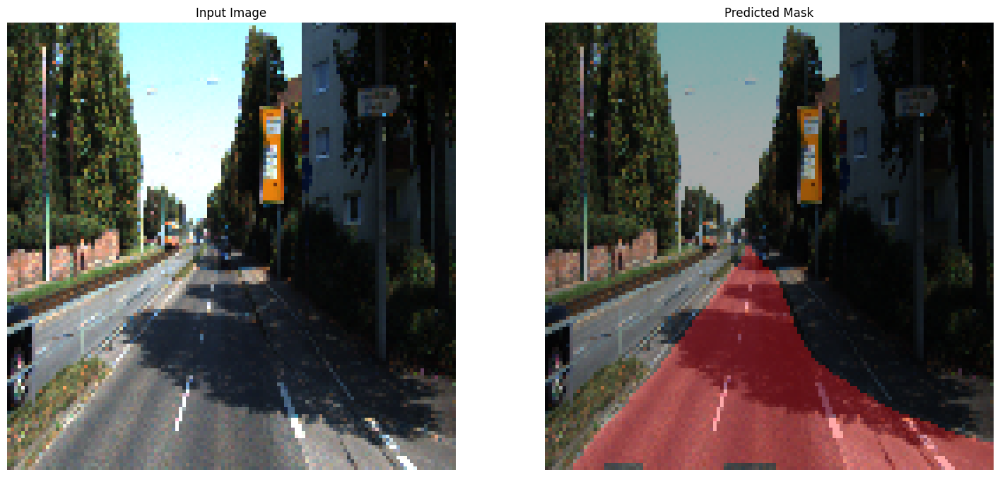

Processing image : 4
1/1 [==============================] - 0s 347ms/step


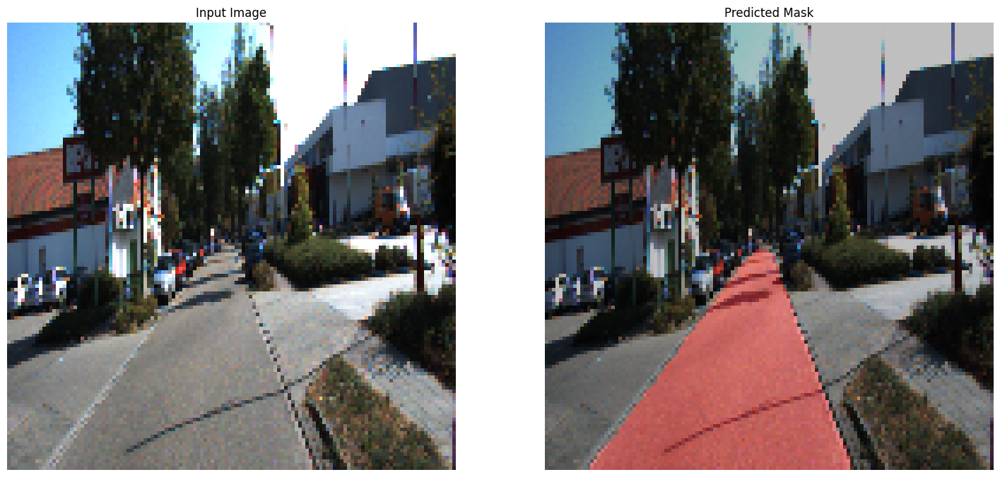

Processing image : 5
1/1 [==============================] - 0s 339ms/step


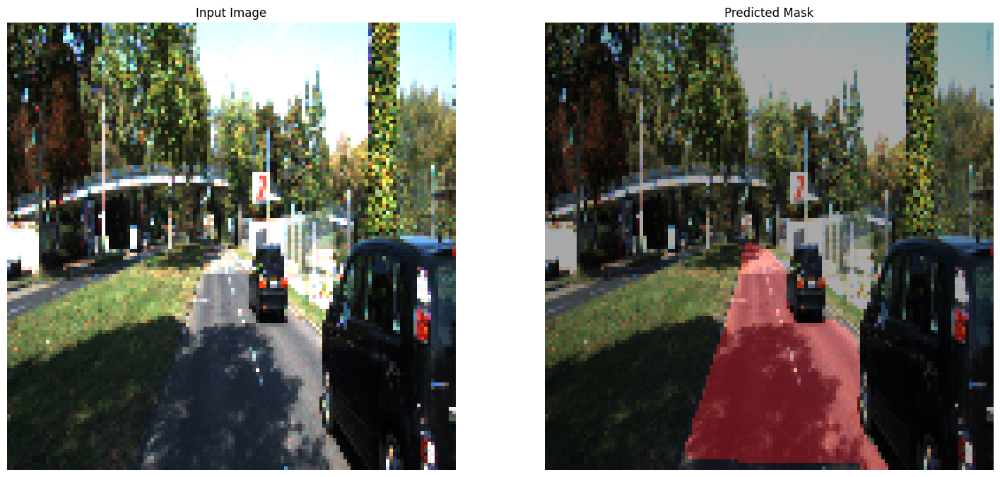

Processing image : 6
1/1 [==============================] - 0s 338ms/step


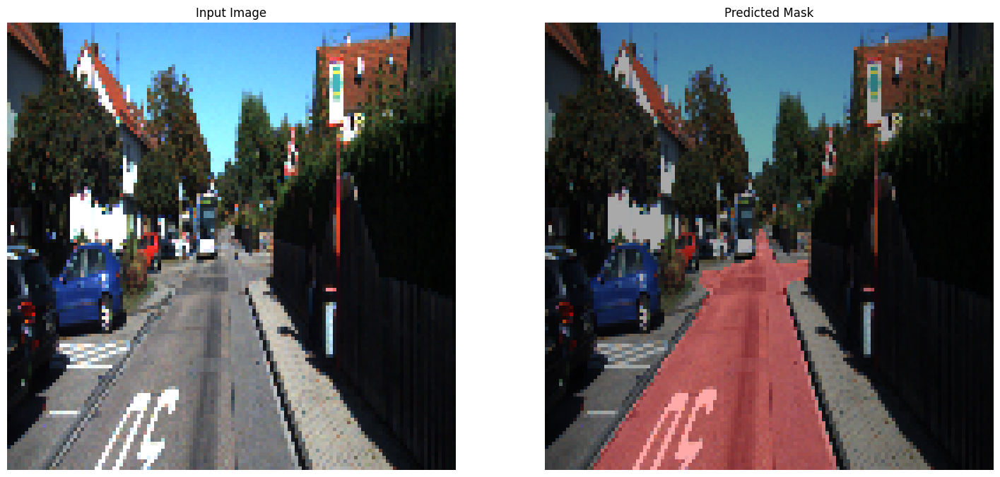

Processing image : 7
1/1 [==============================] - 0s 335ms/step


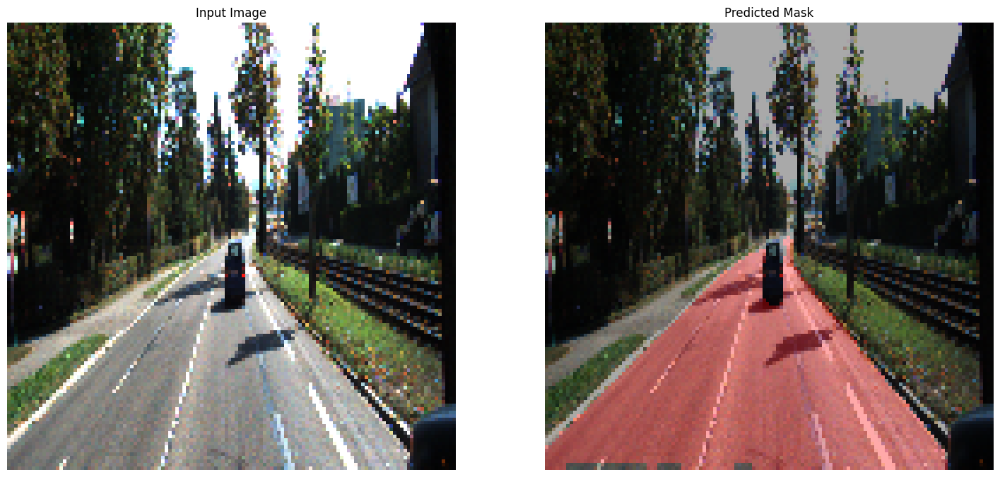

Processing image : 8
1/1 [==============================] - 0s 343ms/step


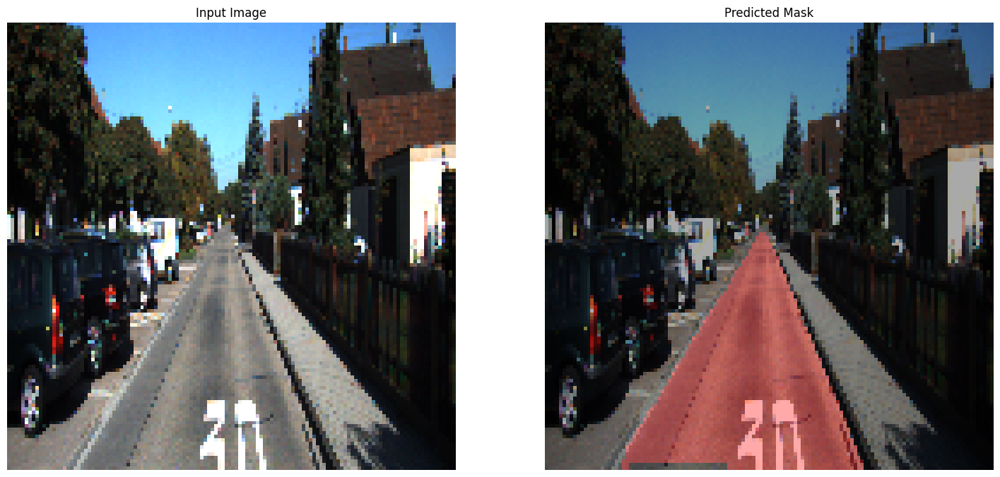

Processing image : 9
1/1 [==============================] - 0s 342ms/step


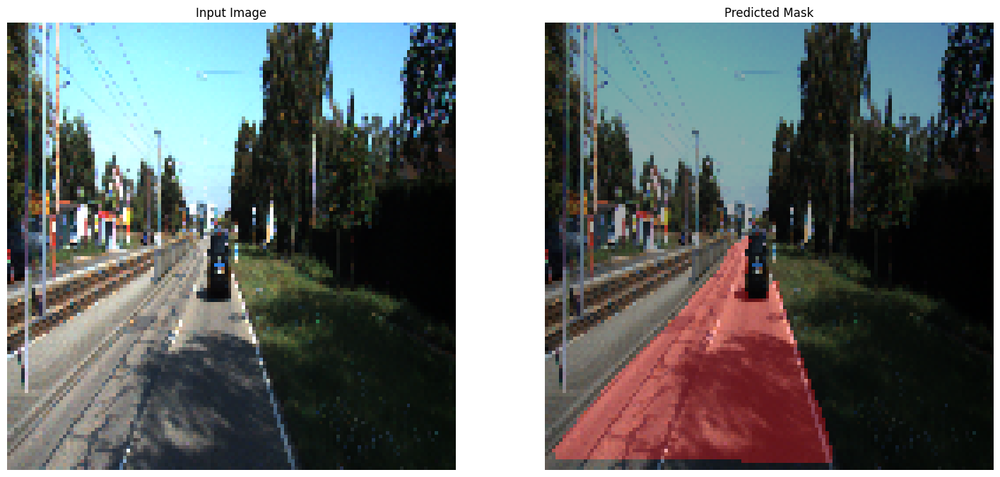

Processing image : 10
1/1 [==============================] - 0s 343ms/step


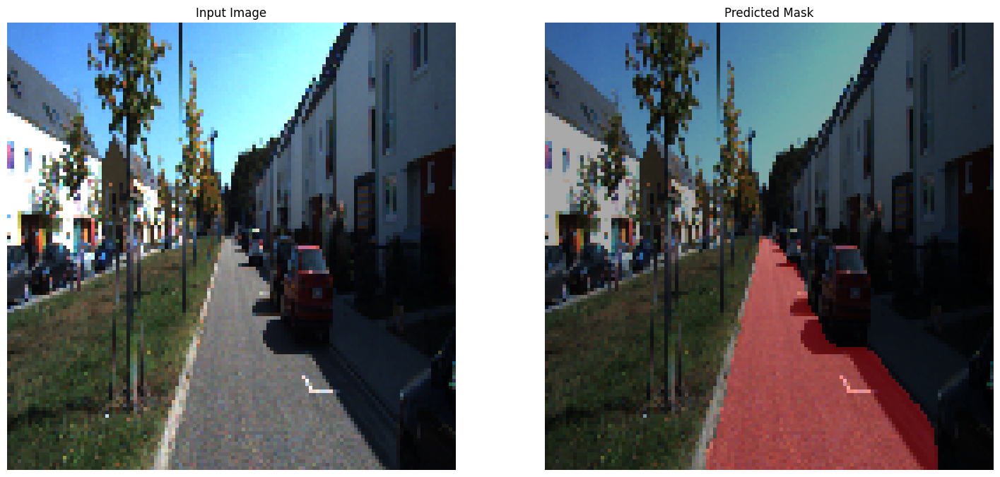

Processing image : 11
1/1 [==============================] - 0s 354ms/step


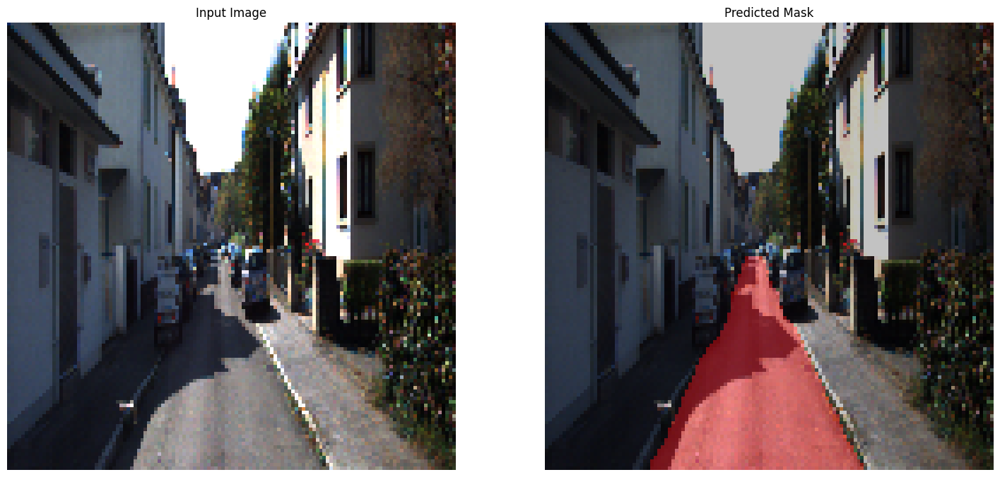

Processing image : 12
1/1 [==============================] - 0s 347ms/step


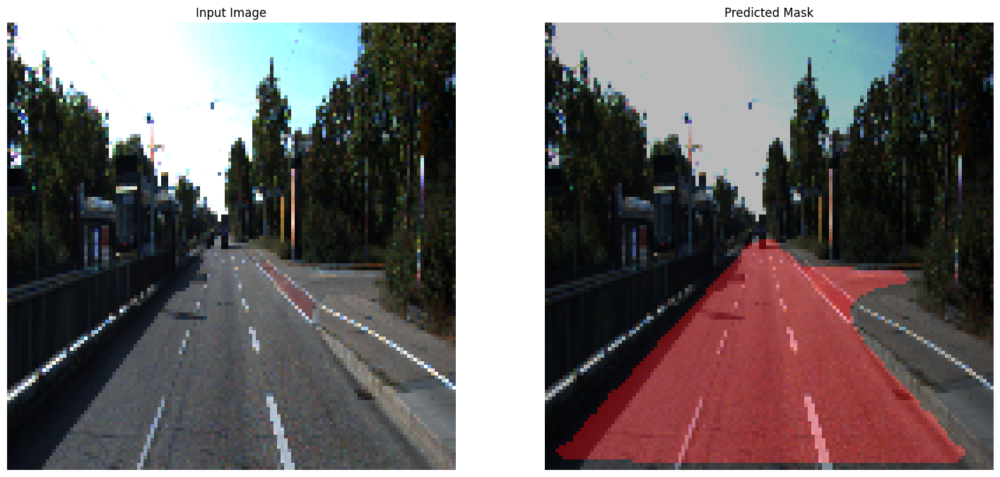

Processing image : 13
1/1 [==============================] - 0s 345ms/step


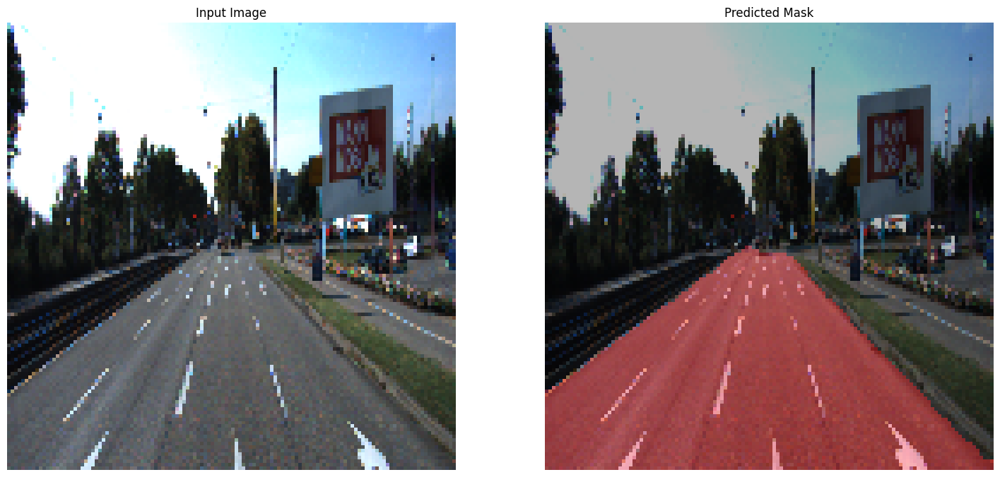

Processing image : 14
1/1 [==============================] - 0s 341ms/step


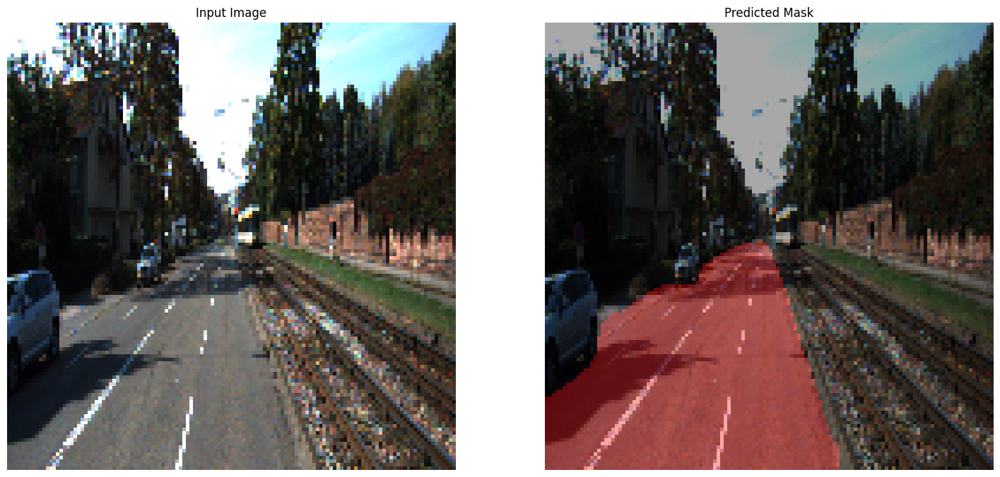

Processing image : 15
1/1 [==============================] - 0s 336ms/step


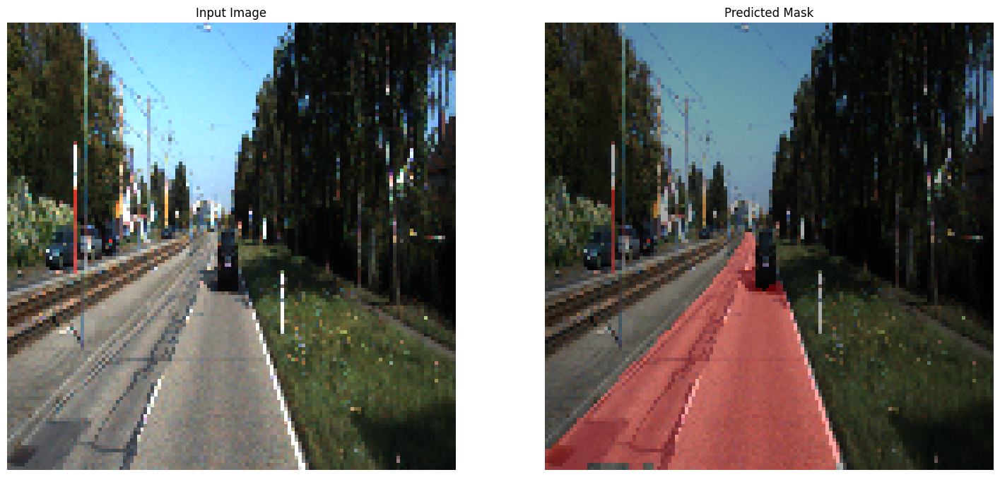

Processing image : 16
1/1 [==============================] - 0s 350ms/step


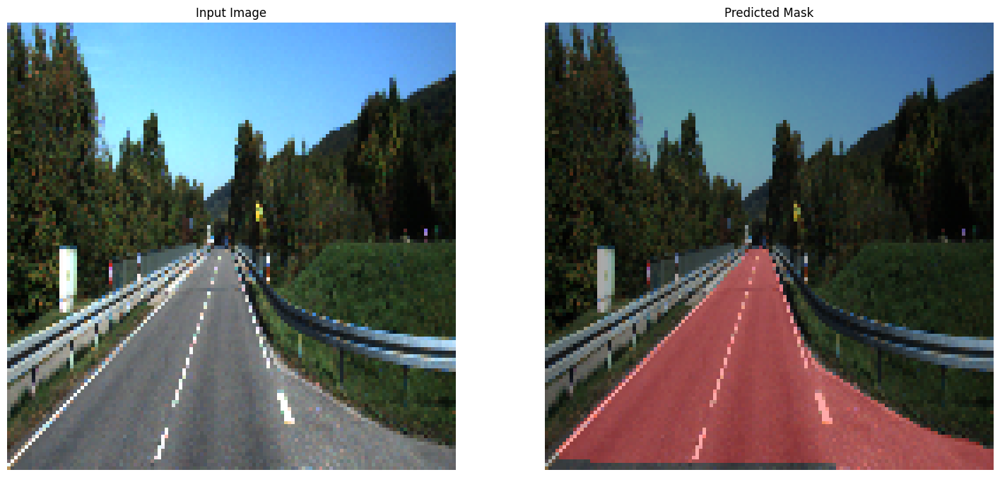

Processing image : 17
1/1 [==============================] - 0s 369ms/step


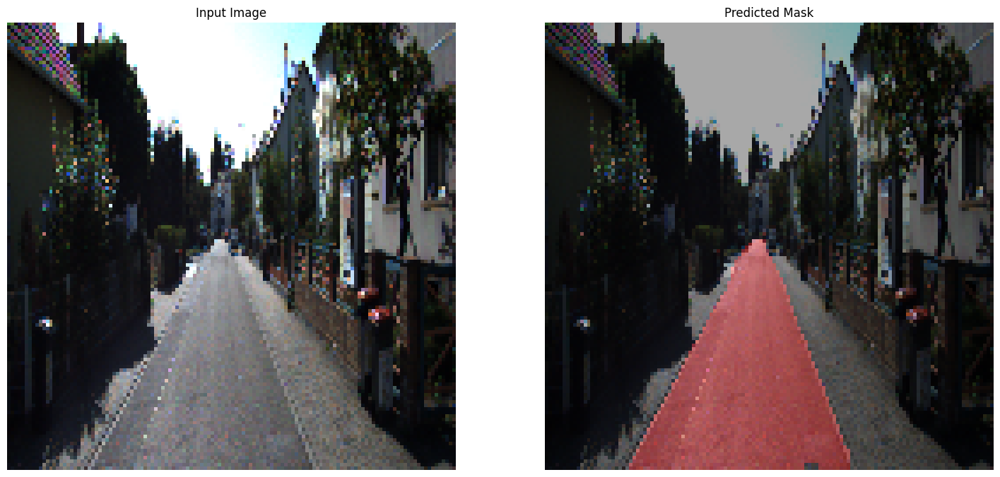

Processing image : 18
1/1 [==============================] - 0s 341ms/step


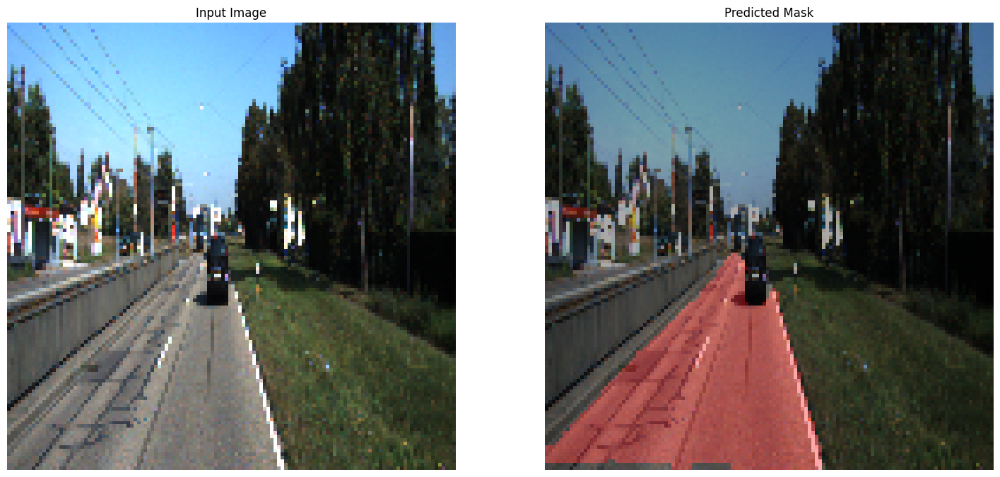

Processing image : 19
1/1 [==============================] - 0s 344ms/step


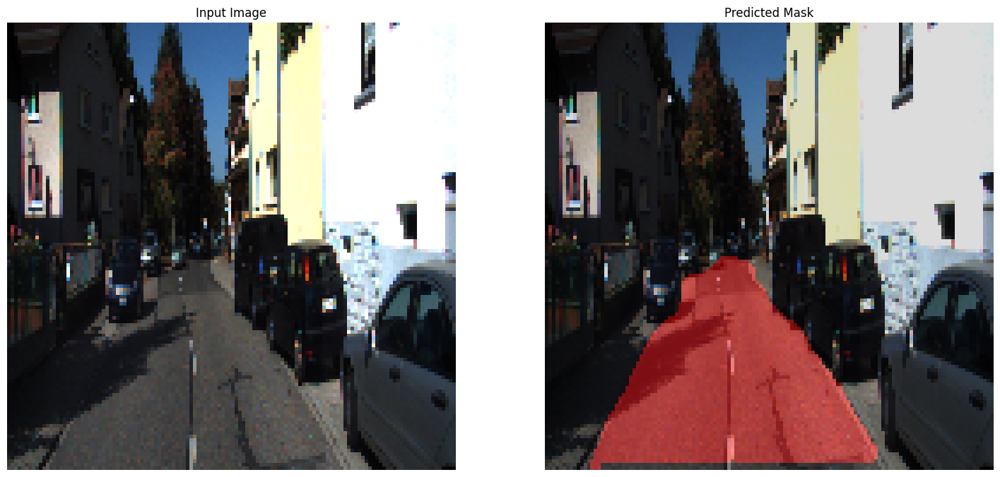

Processing image : 20
1/1 [==============================] - 0s 350ms/step


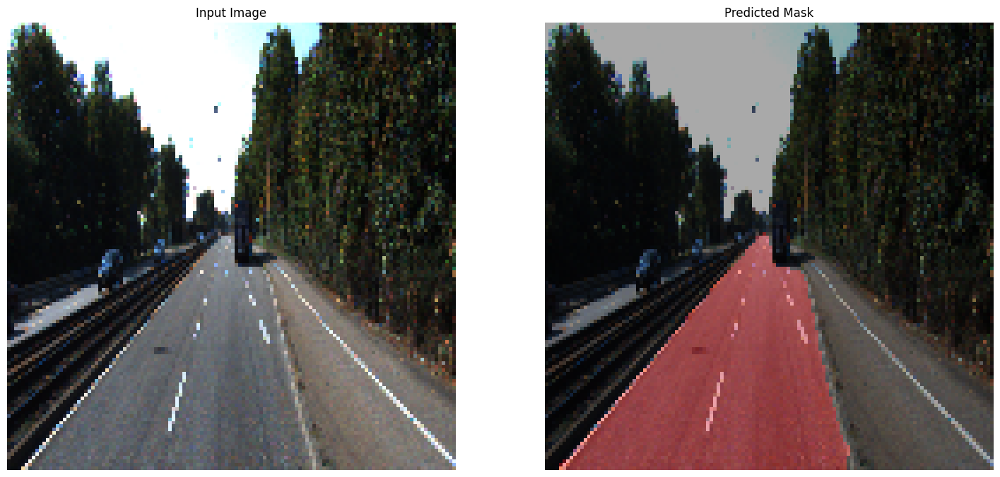

Processing image : 21
1/1 [==============================] - 0s 339ms/step


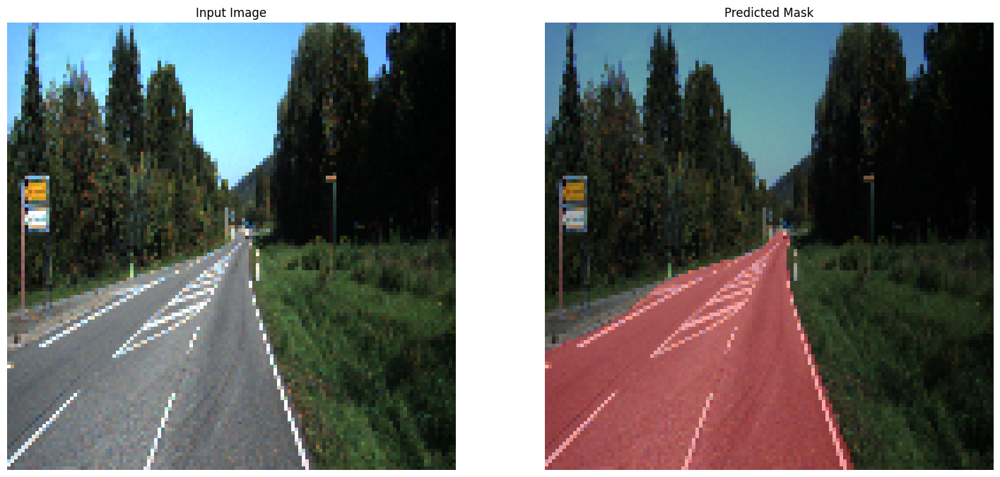

Processing image : 22
1/1 [==============================] - 0s 340ms/step


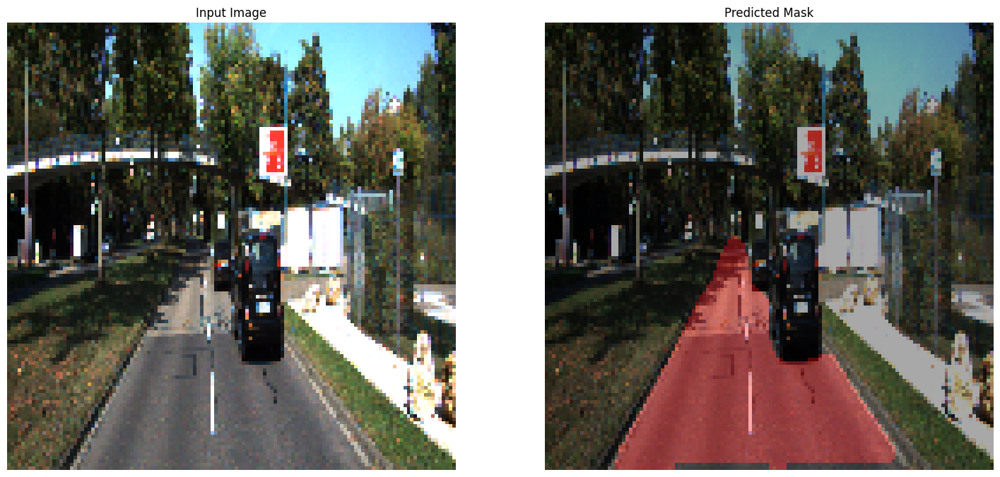

Processing image : 23
1/1 [==============================] - 0s 344ms/step


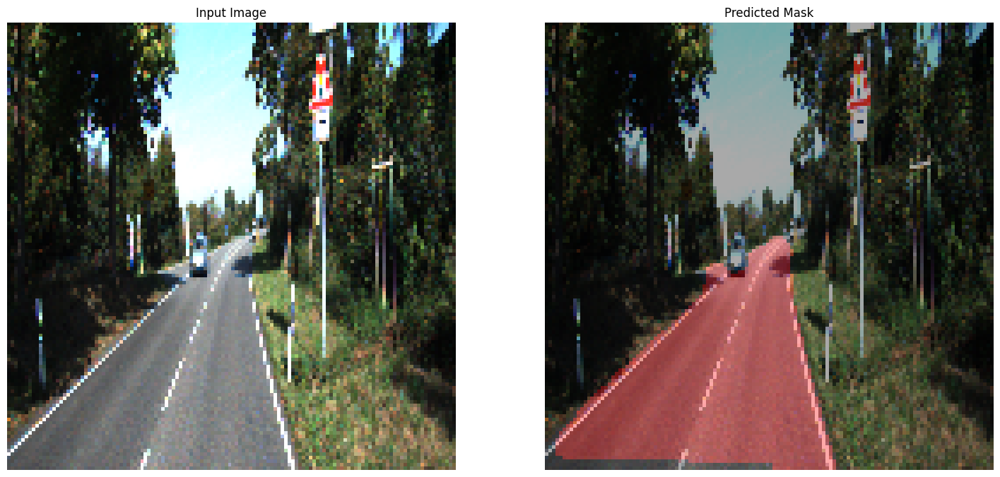

Processing image : 24
1/1 [==============================] - 0s 337ms/step


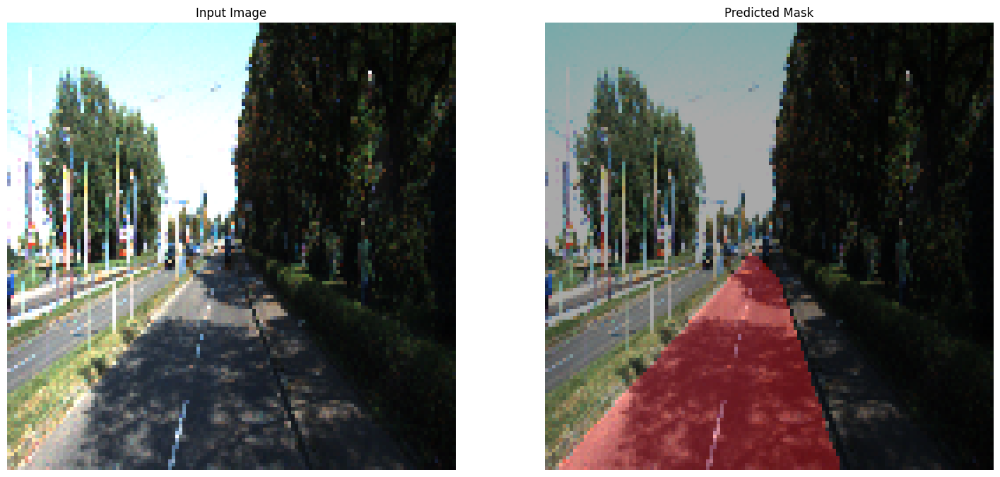

Processing image : 25
1/1 [==============================] - 0s 341ms/step


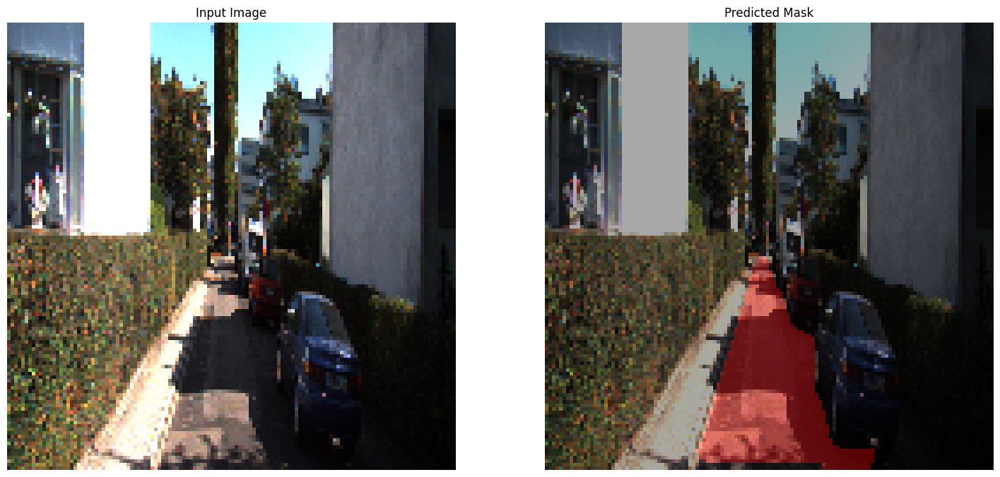

Processing image : 26
1/1 [==============================] - 0s 338ms/step


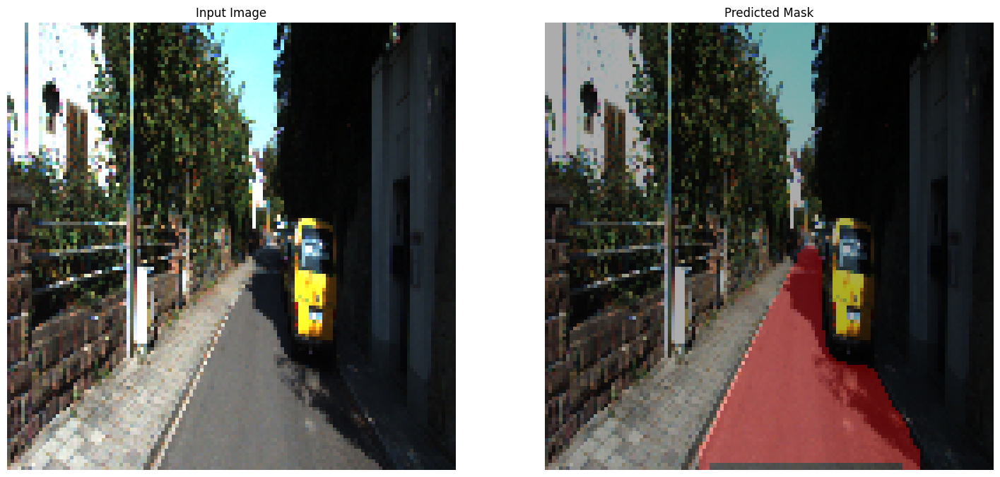

Processing image : 27
1/1 [==============================] - 0s 337ms/step


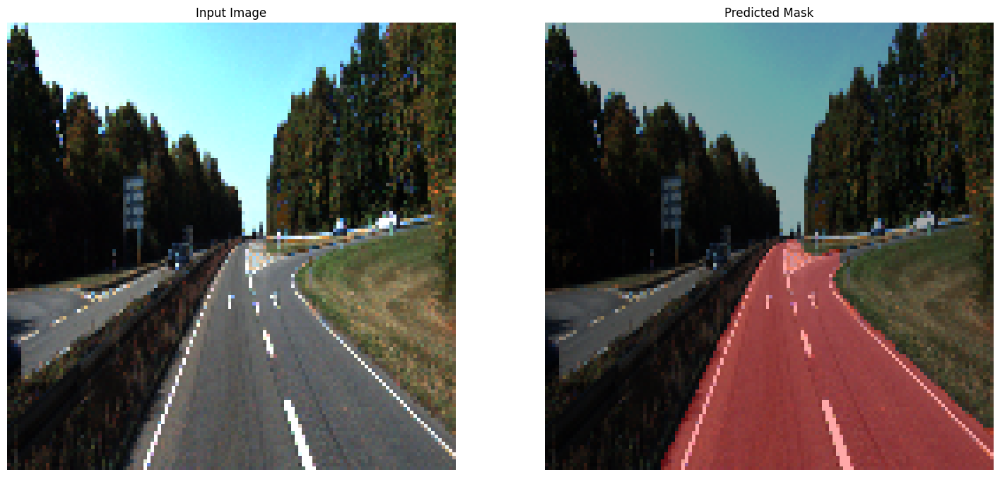

Processing image : 28
1/1 [==============================] - 0s 350ms/step


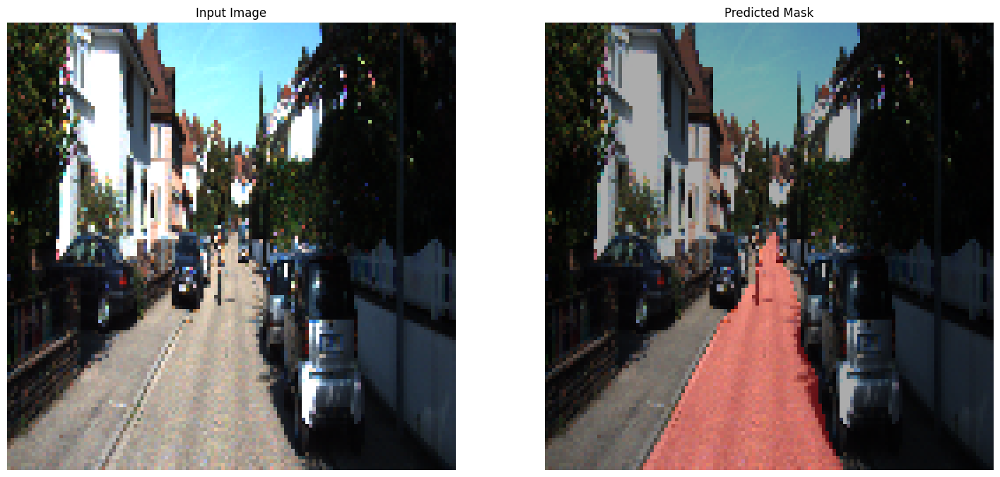

Processing image : 29
1/1 [==============================] - 0s 344ms/step


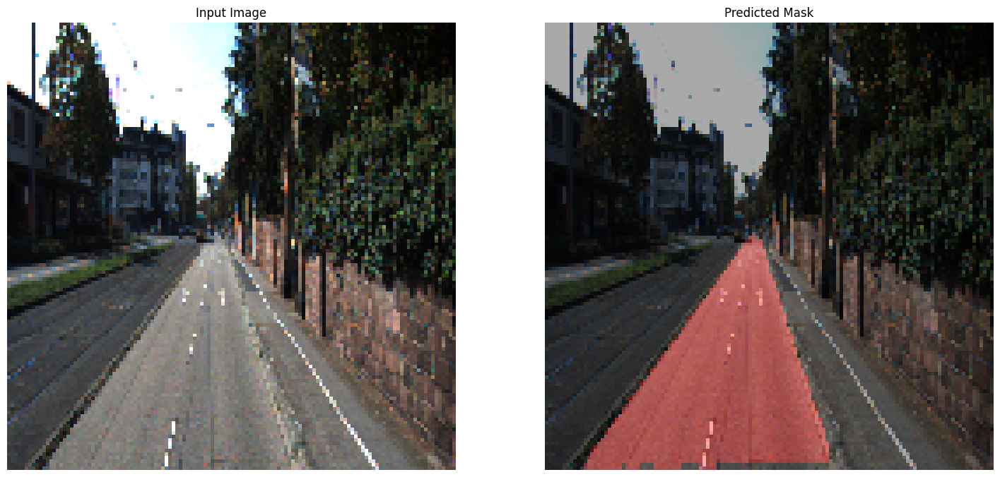

In [ ]:
os.mkdir("/content/drive/MyDrive/ComputerVisionProjects/final_outputs")
save_predictions(dataset['test'])

In [ ]:
%load_ext tensorboard
%tensorboard --logdir logs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

In [ ]:
from base64 import b64encode
from IPython.display import clear_output, HTML

# Function to view video
def play(filename):
    html = ''
    video = open(filename,'rb').read()
    src = 'data:video/mp4;base64,' + b64encode(video).decode()
    html += '<video width=1000 controls autoplay loop><source src="%s" type="video/mp4"></video>' % src
    return HTML(html)

In [ ]:
# Function to process an individual image
def process_image(image):
    # Preprocess image
    image = cv2.resize(image, (IMG_SIZE, IMG_SIZE))
    # Get the binary mask
    pred_mask = model.predict(np.expand_dims(image, axis = 0))
    mask = np.round_(pred_mask[0])

    # Convert to mask image
    zero_image = np.zeros_like(mask)
    mask = np.dstack((mask, zero_image, zero_image)) * 255
    mask = np.asarray(mask, np.uint8)

    # Get the final image
    final_image = weighted_img(mask, image)
    final_image = cv2.resize(final_image, (1280, 720))

    return final_image

In [ ]:
# Make a new directory
os.mkdir("/content/drive/MyDrive/ComputerVisionProjects/final_videos")

In [ ]:
# Creating a VideoCapture object to read the video

def create_video_capture(video_name):
    original_video = cv2.VideoCapture(test_data_dir + video_name)
    frame_width = int(original_video.get(3))
    frame_height = int(original_video.get(4))

    # Define the codec and create VideoWriter object.The output is stored in 'outpy.avi' file.
    fourcc = cv2.VideoWriter_fourcc('m','p','4','v')
    fps = 60
    output = cv2.VideoWriter("/content/drive/MyDrive/ComputerVisionProjects/final_videos/" + video_name, fourcc, fps, (frame_width,frame_height))

    # Process Video
    while(original_video.isOpened()):
        ret, frame = original_video.read()

        if ret == True:
            # Write the frame into the file 'output.avi'
            output.write(process_image(frame))

        else:
            break

    # When everything done, release the video capture and video write objects
    original_video.release()
    output.release()

In [ ]:
create_video_capture("testvideo1.mp4")
play("/content/drive/MyDrive/ComputerVisionProjects/final_videos/" + "testvideo1.mp4")

1/1 [==============================] - 0s 321ms/step


In [ ]:
# Define the path where you want to save the model
model_save_path = '/content/drive/MyDrive/ComputerVisionProjects/trained_models/fusion_model.h5'

# Save the model
model.save(model_save_path)

print(f"Model saved to {model_save_path}")

Model saved to /content/drive/MyDrive/ComputerVisionProjects/trained_models/fusion_model.h5


In [ ]:
create_video_capture("testvideo2.mp4")
play("/content/drive/MyDrive/ComputerVisionProjects/final_videos/" + "testvideo2.mp4")

NameError: name 'create_video_capture' is not defined

In [ ]:
!python --version


Python 3.10.12
